## AST Model with String Classes

### Libraries

In [1]:
import sys
import os
import re

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import torch
from torch.optim import Adam
from transformers import ASTConfig, ASTModel

from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
from torch.cuda.amp import GradScaler, autocast
import torch.nn as nn

from sklearn.model_selection import train_test_split

import warnings
warnings.filterwarnings('ignore')

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

import librosa
import noisereduce as nr
import pickle
from moviepy.editor import VideoFileClip

from tqdm.notebook import tqdm


/home/chijuiwu/anaconda3/lib/python3.11/site-packages/transformers/utils/generic.py:260: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(


In [2]:
# os.environ['PYTORCH_CUDA_ALLOC_CONF'] = 'expandable_segments:True'

### Import the MFCC and Spectrogram, Processing

In [3]:
# Load the MFCC dataset
with open('mfcc_dataset_list.pkl', 'rb') as mfcc_file_list:
    mfcc_dataset = pickle.load(mfcc_file_list)


# Load the spectrogram dataset
with open('spectrogram_dataset_list.pkl', 'rb') as spectrogram_file_list:
    spectrogram_dataset = pickle.load(spectrogram_file_list)
    


In [4]:
# Check the dataset shape
print(spectrogram_dataset[0]['spectrogram'])
print(spectrogram_dataset[0]['spectrogram'].shape)

[[-8.287623  -8.287623  -8.287623  ... -2.829914  -2.9057107 -2.9057107]
 [-8.287623  -8.287623  -8.287623  ... -2.9327095 -2.9627967 -2.9627967]
 [-8.287623  -8.287623  -8.287623  ... -3.37057   -3.3034296 -3.3034296]
 ...
 [-8.287623  -8.287623  -8.287623  ... -8.287623  -8.287623  -8.287623 ]
 [-8.287623  -8.287623  -8.287623  ... -8.287623  -8.287623  -8.287623 ]
 [-8.287623  -8.287623  -8.287623  ... -8.281083  -8.2801485 -8.2801485]]
(1024, 128)


In [5]:
# Iterate through each item in the dataset
for item in spectrogram_dataset:
    # Convert the action list to a string
    action_string = ''.join(str(num) for num in item['action'])
    
    # Replace the action list with its string representation
    item['action'] = action_string

# Verify by printing the first few modified items
for item in spectrogram_dataset[:5]:
    print(item)


{'file_id': 'W1XD0EGO', 'sample_rate': 16000, 'start_sec': 0, 'end_sec': 1, 'spectrogram': array([[-8.287623 , -8.287623 , -8.287623 , ..., -2.829914 , -2.9057107,
        -2.9057107],
       [-8.287623 , -8.287623 , -8.287623 , ..., -2.9327095, -2.9627967,
        -2.9627967],
       [-8.287623 , -8.287623 , -8.287623 , ..., -3.37057  , -3.3034296,
        -3.3034296],
       ...,
       [-8.287623 , -8.287623 , -8.287623 , ..., -8.287623 , -8.287623 ,
        -8.287623 ],
       [-8.287623 , -8.287623 , -8.287623 , ..., -8.287623 , -8.287623 ,
        -8.287623 ],
       [-8.287623 , -8.287623 , -8.287623 , ..., -8.281083 , -8.2801485,
        -8.2801485]], dtype=float32), 'action': '00000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000001000000010000000000000000000000000000000000'}
{'file_id': 'W1XD0EGO', 'sample_rate': 16000, 'start_sec': 1, 'end_sec': 2, 'spectrogram': array([[-2.0592518, -2.0592518, -2.00679  , ..., -2.4

In [6]:
# List to hold all action strings for further analysis or use
all_action_strings = []

# Loop through each item in the dataset
for item in spectrogram_dataset:
    # Extract the action list
    action_list = item['action']
    
    # Convert each integer in the list to a string and concatenate them
    action_string = ''.join(str(action) for action in action_list)
    
    # Append the action string to the list
    all_action_strings.append(action_string)
    
print(all_action_strings[:5])

['00000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000001000000010000000000000000000000000000000000', '00000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000001000000010000000000000000000000000000000000', '00000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000001000000010000000000000000000000000000000000', '00000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000001000000010000000000000000000000000000000000', '00000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000001000000010000000000000000000000000000000000']


In [7]:
# Dictionary to hold the frequency of each action string
action_string_frequency = {}

# Loop through each action string in all_action_strings
for action_string in all_action_strings:
    if action_string in action_string_frequency:
        action_string_frequency[action_string] += 1
    else:
        action_string_frequency[action_string] = 1

# Print the frequency of each action string
for action_string, count in action_string_frequency.items():
    print(f"Action String: {action_string}, Count: {count}")


Action String: 00000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000001000000010000000000000000000000000000000000, Count: 12
Action String: 00000000000000000000000000000000000000000000000000000000000000000000000000000100000010000000000000000000000000000001000000010000000000000000000000000000000000, Count: 1
Action String: 00000000000000000000000000000000000000000000000000000000000000000000000000000100000010000000000000000000000000000001100000010000000000000000000000000000000000, Count: 2
Action String: 00000000000000000000000000000000000000000000000000000000000000000000000000000100000010100000000000000000000000000001100000010000000000000000000000000000000000, Count: 2
Action String: 00000000000000000000000000000000000000000000000000000000000000000000000000000100000011100000000000000000000000000001100000010000000000000000000000000000000000, Count: 3
Action String: 0000000000000000000000000000000000000000000000000000000000000000

In [9]:
# Convert the list of action strings to a set to remove duplicates
unique_action_strings = set(all_action_strings)

# Convert the set of unique action strings to a sorted list
sorted_unique_action_strings = sorted(unique_action_strings)

# Print sorted unique action strings
print("Sorted Unique Action Strings:")
for action_string in sorted_unique_action_strings:
    print(action_string)

print(f"Total sorted unique action strings: {len(sorted_unique_action_strings)}")


Sorted Unique Action Strings:
00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001
00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100
00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101
00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000
00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001001
00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010001
0000000000000000

In [10]:
# Check the number of classes
num_classes = len(sorted_unique_action_strings)
print(num_classes)

7664


In [11]:
label_to_int = {label: i for i, label in enumerate(sorted_unique_action_strings)}
print(label_to_int)

{'00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001': 0, '00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100': 1, '00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101': 2, '00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000': 3, '00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001001': 4, '00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010001': 5, '00000000

In [12]:
print(len(spectrogram_dataset))

23277


### Funtion of Accuracy Calculation

In [13]:
# Define top_k_accuracy function
def top_k_accuracy(logits, labels, k=5):
    sorted_indices = torch.argsort(logits, dim=1, descending=True)
    topk_indices = sorted_indices[:, :k]
    correct = topk_indices == labels.view(-1, 1)
    correct_k = correct.any(dim=1).float().sum().item()
    return correct_k

### Splite the Training, Validation, and Testing

In [14]:
# First split: 80% Train, 20% Temp
train_set, temp_set = train_test_split(
    spectrogram_dataset, 
    test_size=0.2, 
    random_state=42
)

# Second split: Split the Temp set into 50% Validation, 50% Test
val_set, test_set = train_test_split(
    temp_set, 
    test_size=0.5, 
    random_state=42
)

# Get the number of samples in each set
num_train_samples = len(train_set)
num_val_samples = len(val_set)
num_test_samples = len(test_set)

print("Number of training samples:", num_train_samples)
print("Number of validation samples:", num_val_samples)
print("Number of testing samples:", num_test_samples)

Number of training samples: 18621
Number of validation samples: 2328
Number of testing samples: 2328


### Model Config

In [15]:
custom_config = ASTConfig(
    hidden_act="sigmoid", # (str or function, optional, defaults to "gelu") — The non-linear activation function (function or string) in the encoder and pooler. If string, "gelu", "relu", "selu" and "gelu_new" are supported.
    hidden_size=384, # (int, optional, defaults to 768) — Dimensionality of the encoder layers and the pooler layer.
    num_hidden_layers=6, # (int, optional, defaults to 12) — Number of hidden layers in the Transformer encoder.
    num_attention_heads=6, # (int, optional, defaults to 12) — Number of attention heads for each attention layer in the Transformer encoder.
    intermediate_size=3072, # (int, optional, defaults to 3072) — Dimensionality of the “intermediate” (i.e., feed-forward) layer in the Transformer encoder.
    hidden_dropout_prob=0.4, # (float, optional, defaults to 0.0) — The dropout probability for all fully connected layers in the embeddings, encoder, and pooler.
    attention_probs_dropout_prob=0.0, # (float, optional, defaults to 0.0) — The dropout ratio for the attention probabilities.
    initializer_range=0.02, # (float, optional, defaults to 0.02) — The standard deviation of the truncated_normal_initializer for initializing all weight matrices.
    layer_norm_eps=1e-12, # (float, optional, defaults to 1e-12) — The epsilon used by the layer normalization layers.
    patch_size=16, # (int, optional, defaults to 16) — The size (resolution) of each patch.
    qkv_bias=True, # (bool, optional, defaults to True) — Whether to add a bias to the queries, keys and values.
    frequency_stride=1, # (int, optional, defaults to 10) — Frequency stride to use when patchifying the spectrograms.
    max_length=32, # (int, optional, defaults to 1024) — Temporal dimension of the spectrograms.
    num_mel_bins=1025, # (int, optional, defaults to 128) — Frequency dimension of the spectrograms (number of Mel-frequency bins).
    time_stride=1, # (int, optional, defaults to 10) — Temporal stride to use when patchifying the spectrograms.
)

In [16]:
configuration = custom_config

model = ASTModel(configuration)

# Accessing the model configuration

configuration = model.config

In [17]:
print(configuration)

ASTConfig {
  "attention_probs_dropout_prob": 0.0,
  "frequency_stride": 1,
  "hidden_act": "sigmoid",
  "hidden_dropout_prob": 0.4,
  "hidden_size": 384,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "max_length": 32,
  "model_type": "audio-spectrogram-transformer",
  "num_attention_heads": 6,
  "num_hidden_layers": 6,
  "num_mel_bins": 1025,
  "patch_size": 16,
  "qkv_bias": true,
  "time_stride": 1,
  "transformers_version": "4.32.1"
}



### Model Training Setting

In [18]:
batch_size = 8

train_dataloader = DataLoader(train_set, batch_size=batch_size, shuffle=True)
val_dataloader = DataLoader(val_set, batch_size=batch_size, shuffle=True)
test_dataloader = DataLoader(test_set, batch_size=batch_size, shuffle=True)

In [19]:
torch.cuda.set_device(1)# Set the number of GPU to use the target GPU

model = ASTModel(config=ASTConfig())
final_layer = nn.Linear(768, num_classes)

if torch.cuda.is_available():
    model = model.cuda()
    final_layer = final_layer.cuda()

optimizer = Adam(list(model.parameters()) + list(final_layer.parameters()), lr=0.01)
loss_fn = torch.nn.CrossEntropyLoss()


### Training Process

In [20]:
num_epochs = 15
num_classes = len(label_to_int)  # Assuming label_to_int is defined

# Initialize dictionaries to track correct and total counts per class for both training and validation
correct_per_class_train = {class_id: 0 for class_id in label_to_int.values()}
total_per_class_train = {class_id: 0 for class_id in label_to_int.values()}
correct_per_class_val = {class_id: 0 for class_id in label_to_int.values()}
total_per_class_val = {class_id: 0 for class_id in label_to_int.values()}

# Initialize lists to store loss and accuracy values for each epoch
train_losses = []
train_accuracies = []
val_losses = []
val_accuracies = []
val_top1_accuracies = []
val_top5_accuracies = []

for epoch in range(num_epochs):
    
    # Initialize accuracy tracking variables
    correct_train = 0
    total_train = 0
    correct_val = 0
    val_top1_correct = 0
    val_top5_correct = 0
    total_val = 0

    # Training phase
    model.train()
    total_train_loss = 0
    train_progress_bar = tqdm(train_dataloader, desc=f"Epoch {epoch+1}/{num_epochs} [Train]", leave=False, mininterval=1)
    for batch in train_progress_bar:
        
        optimizer.zero_grad()
        inputs = batch['spectrogram']
        labels = torch.tensor([label_to_int[label] for label in batch['action']], dtype=torch.long)

        if torch.cuda.is_available():
            inputs, labels = inputs.cuda(), labels.cuda()

        outputs = model(inputs)
        logits = final_layer(outputs.last_hidden_state[:, 0, :])  # Adjust according to actual output structure
        loss = loss_fn(logits, labels)
        loss.backward()
        optimizer.step()
        

        total_train_loss += loss.item()

        _, predicted = torch.max(logits.data, 1)
        total_train += labels.size(0)
        correct_train += (predicted == labels).sum().item()

        # Update training per-class accuracy
        for i, label in enumerate(labels.cpu().numpy()):
            total_per_class_train[label] += 1
            if predicted[i] == label:
                correct_per_class_train[label] += 1
        train_progress_bar.set_description(f"Epoch {epoch+1}/{num_epochs} [Train] Loss: {loss.item():.4f}")

    avg_train_loss = total_train_loss / len(train_dataloader)
    train_accuracy = correct_train / total_train
    
    
    # Validation phase
    model.eval()
    total_val_top1_correct = 0
    total_val_top5_correct = 0
    total_val_samples = 0
    total_val_loss = 0
    with torch.no_grad():
        val_progress_bar = tqdm(val_dataloader, desc=f"Epoch {epoch+1}/{num_epochs} [Validate]", leave=False)
        for batch in val_progress_bar:
            inputs = batch['spectrogram']
            labels = torch.tensor([label_to_int[label] for label in batch['action']], dtype=torch.long)

            if torch.cuda.is_available():
                inputs, labels = inputs.cuda(), labels.cuda()

            outputs = model(inputs)
            logits = final_layer(outputs.last_hidden_state[:, 0, :])
            val_loss = loss_fn(logits, labels)

            total_val_loss += val_loss.item()

            _, predicted = torch.max(logits.data, 1)
            total_val += labels.size(0)
            correct_val += (predicted == labels).sum().item()

            # Update validation per-class accuracy
            for i, label in enumerate(labels.cpu().numpy()):
                total_per_class_val[label] += 1
                if predicted[i] == label:
                    correct_per_class_val[label] += 1
            val_progress_bar.set_description(f"Epoch {epoch+1}/{num_epochs} [Validate] Loss: {val_loss.item():.4f}")
            
            # Calculate top-k accuracy
            total_val_samples += labels.size(0)
            total_val_top1_correct += top_k_accuracy(logits, labels, k=1)
            total_val_top5_correct += top_k_accuracy(logits, labels, k=5)  
            
    avg_val_loss = total_val_loss / len(val_dataloader)
    val_accuracy = correct_val / total_val
    


    # Print training and validation results
    print(f"Epoch {epoch+1}/{num_epochs}, "
          f"Training Loss: {avg_train_loss:.4f}, Training Accuracy: {train_accuracy:.4f}, "
          f"Validation Loss: {avg_val_loss:.4f}, Validation Accuracy: {val_accuracy:.4f}")
    
    #Top k accuracy
    val_top1_accuracy = total_val_top1_correct / total_val_samples * 100
    val_top5_accuracy = total_val_top5_correct / total_val_samples * 100
    print(f"Validation Top-1 Accuracy: {val_top1_accuracy:.2f}%, Top-5 Accuracy: {val_top5_accuracy:.2f}%")
    

    # Calculate and print per-class accuracies
    for class_id in label_to_int.values():
        class_name = [name for name, id_ in label_to_int.items() if id_ == class_id][0]

        if total_per_class_train[class_id] > 0:
            train_acc = correct_per_class_train[class_id] / total_per_class_train[class_id]
            print(f"Class {class_name} - Train Accuracy: {train_acc:.4f}")

        if total_per_class_val[class_id] > 0:
            val_acc = correct_per_class_val[class_id] / total_per_class_val[class_id]
            print(f"Class {class_name} - Validation Accuracy: {val_acc:.4f}")
    

    # Append loss and accuracy values for this epoch
    train_losses.append(avg_train_loss)
    train_accuracies.append(train_accuracy)
    val_losses.append(avg_val_loss)
    val_accuracies.append(val_accuracy)  
    val_top1_accuracies.append(val_top1_accuracy)
    val_top5_accuracies.append(val_top5_accuracy)

Epoch 1/15 [Train]:   0%|          | 0/2328 [00:00<?, ?it/s]

Epoch 1/15 [Validate]:   0%|          | 0/291 [00:00<?, ?it/s]

Epoch 1/15, Training Loss: 9.0766, Training Accuracy: 0.0984, Validation Loss: 8.8336, Validation Accuracy: 0.1284
Validation Top-1 Accuracy: 12.84%, Top-5 Accuracy: 13.49%
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.8007
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 1.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000000000000000000000000000010100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000010111010000000000000000000000000010000000000000000000001010000000000000000000000000000000100001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000010111110000000000000000000000010010000000000000000000001010000000000000000000000000000000100001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000

Class 00000000000000000000000000000000001100000000000000000000000000000000000000001000000000000000000000000000000000000000000000000000000000000000000000000100000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000001100000000000000000000000000000000000000001000000000000000000000000000000000000000000000000000000000000000000000000100000001 - Validation Accuracy: 0.0000
Class 00000000000000000000000000000000001100000000000000000000000000000000000000001000000000000000000000000000000000000000000000000010000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000001100000000000000000000000000000000000000001100000000000000000000000000000000000000000000000000000000000000000000000100000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000001100000000000000000000000000000000000000001100100000000000000000000000000000000000000000000000000000000000000000000100000001 - Train Accuracy: 0.0000
Class 000000000000000000000000000000000011000

Class 00000000000000010000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000010000000001 - Train Accuracy: 0.0000
Class 00000000000000010000000000100000000000000000000000000000000001000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000001 - Train Accuracy: 0.0000
Class 00000000000000010000000000100000000000000000000000000000000001000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000010 - Train Accuracy: 0.0000
Class 00000000000000010000000000100000000000000000000000000000000001000000000000000000000000000000000000000000000000000000001000000000000000000000000000010000000001 - Train Accuracy: 0.0000
Class 00000000000000010000000000100000000000000000000000000000000001010000000000000000000000000000000000000000000000000000001000000000000000000000000000010000000001 - Train Accuracy: 0.0000
Class 00000000000000010000000000100000000000000000

Class 00000000010000000000000000000000000000011110100000000000000000000000000000000000000000000000000000000000000100100000000000000000110000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000011110100000000000000000000000000000000000000000000000000000000000001100100000000000000000110000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000010000000000000000001001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000010001000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000100000

Class 00100000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00100000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00100000000010000000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000000000000000000011000000010000000000000000000001 - Train Accuracy: 0.0000
Class 00100000000010000000000000000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00100000000010000000000000000001000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00100000000011000000000000000000000000100000

Epoch 2/15 [Train]:   0%|          | 0/2328 [00:00<?, ?it/s]

Epoch 2/15 [Validate]:   0%|          | 0/291 [00:00<?, ?it/s]

Epoch 2/15, Training Loss: 8.3728, Training Accuracy: 0.1229, Validation Loss: 9.2601, Validation Accuracy: 0.1284
Validation Top-1 Accuracy: 12.84%, Top-5 Accuracy: 12.93%
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.9003
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 1.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000100000000001010000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000101100000000000001100000000000000000000100000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000110000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000001000000000000001000000000000000000000000000000000011 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000001000000000001000000000000000000000000100000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000

Class 00000000000000000000000000000000010000100000000000000000000000000000000100000000000000000000000000000000000000000000000000000001000000000000000000100000000001 - Validation Accuracy: 0.0000
Class 00000000000000000000000000000000010000100000000000000000000000000000001000000000000000101000010100000000000000000000000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000010000100000000000000000000000000000001000000000000000101000010100000000000000000000000000000000000000000000000000000000000000 - Validation Accuracy: 0.0000
Class 00000000000000000000000000000000010000100000000000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000010000101000000100000000000001000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 0000000000000000000000000000000001

Class 00000000000000010100000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000010100000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010001 - Train Accuracy: 0.0000
Class 00000000000000010100000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000110000 - Train Accuracy: 0.0000
Class 00000000000000010110000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00000000000000010110000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000010110000000000000000000000000

Class 00000000010000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000001100000000000000000000000000000000000000000000100000 - Train Accuracy: 0.0000
Class 00000000010000000000010000000000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000010000000000010000000000000000000000000000000000000001000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000010000000000000000000000000000000000000001000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000001 - Validation Accuracy: 0.0000
Class 00000000010000000000010100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 000000000100000000000101000000000000000

Class 00111000000011000000000000000000011000100000000000000000000000000000000100000000000000000000000000010000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 01000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 01000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 01000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000000001 - Train Accuracy: 0.0000
Class 01000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000001001 - Train Accuracy: 0.0000
Class 01000000000000000000000000000000000000000000

Epoch 3/15 [Train]:   0%|          | 0/2328 [00:00<?, ?it/s]

Epoch 3/15 [Validate]:   0%|          | 0/291 [00:00<?, ?it/s]

Epoch 3/15, Training Loss: 8.2947, Training Accuracy: 0.1229, Validation Loss: 9.3355, Validation Accuracy: 0.1284
Validation Top-1 Accuracy: 12.84%, Top-5 Accuracy: 13.57%
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.9336
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 1.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000000000000000000000000000000000001010010000000000000000000000000000000000000000000000000000000000000000000000100000001001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001010010000000000000000000000000000000000000000000000000000000000100000000000100000001001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001010010000000000000000000000000000000000000000000000000000000001100000000000100000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001010010000000000000000000000000000000000000000000000000000000001100000000000100000000001 - Validation Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001010100010000000000000000000000000000000000000000000000000000000000000000000100000001001 - Train Accuracy: 0.0000
Class 000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000010100100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000011000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000011000000000000000000000000000000000000000000000000000000000100000000000000000000000000001000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000011000000000000000000000000000000000000000000000000000000000100010000000000000000000000001000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000011001000000000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000011001

Class 00000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000100000000000000101101000 - Train Accuracy: 0.0000
Class 00000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000100000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000001000000000000000000110000000000000100100000 - Train Accuracy: 0.0000
Class 00000000000000000100000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000001000000000000000000110000000000000100100000 - Validation Accuracy: 0.0000
Class 000000000000000001000000000000000000000

Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000110000000100000000000000001001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000100000000100000000000000011001 - Validation Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000110000000100000000000000001001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000110000000100000000000000011001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000110000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 000000000100000000000000000000000000000

Class 00001000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00001000000000000000000001010000000000001001000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000001 - Train Accuracy: 0.0000
Class 00001000000000000000000001010010000000001001000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000001 - Train Accuracy: 0.0000
Class 00001000000000000000000001010010000000001001000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000001 - Validation Accuracy: 0.0000
Class 00001000000000000000000001011000100000000000000000000010000000000000000000000000000000000000000000000000000000000110000000000001000000000000000000000001001001 - Train Accuracy: 0.0000
Class 000010000000000000000100000000000000000

Epoch 4/15 [Train]:   0%|          | 0/2328 [00:00<?, ?it/s]

Epoch 4/15 [Validate]:   0%|          | 0/291 [00:00<?, ?it/s]

Epoch 4/15, Training Loss: 8.2754, Training Accuracy: 0.1227, Validation Loss: 9.6183, Validation Accuracy: 0.1284
Validation Top-1 Accuracy: 12.84%, Top-5 Accuracy: 13.19%
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.9498
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 1.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000000000000000000000000000000000001100010000000000000000000000000000000000000000000000000001000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001100010000000000000000000000000000000000000000000000000001000000000000000000000000000001 - Validation Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001100010000000000000000000000000000000000000000000010000000000000000000000000000000010000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001100010000000000000000000000000000000000000000001010000000000000000000000000000000010000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001100100000000000000000000000000000000000000000000000000000000000010000000000100000001001 - Train Accuracy: 0.0000
Class 000000000000000000000000000000000000000

Class 00000000000000000000000000000000000001100000000000000000000000000000000000000000000000000000000100000000001000000000000000000100000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000001100000000000000000000000000000000000000000000000000000000110000000000000000000000000000000000000000000000000000000100000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000001100000000000000000000000000000000000000000000000000000000110000000000000000000000000000000000000000000000000000000100000 - Validation Accuracy: 0.0000
Class 00000000000000000000000000000000000001100000000000000000000000000000000000000000000000000000001110000000000000000000000000000000000000000000000000000000100000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000001100000000000000000000000000000000000000000000000000001100000000000000000000010000000000000000000000000000000000000001000 - Train Accuracy: 0.0000
Class 000000000000000000000000000000000000100

Class 00000000000000001000000001010000100000000000000000000000000100000000000000000000000000010000000000000000000000000001000000010000000000000000000000000000000000 - Validation Accuracy: 0.0000
Class 00000000000000001000000001111000100000000000000000000000000100000000000000000000000000010000000000000000000000000001000000010000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000001000000001111000100000000000000000000000000100000000000000000000000000010000000000000000000000000001000000010000000000000000000000000000100000 - Train Accuracy: 0.0000
Class 00000000000000001000000001111100100000000000000000000000000100000000000000000000000000010000000000000000000000000001000000010000000000000000000000000000100000 - Train Accuracy: 0.0000
Class 00000000000000001000001000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000110000000000000000000000001000001 - Train Accuracy: 0.0000
Class 000000000000000010000010000000000000000

Class 00000000010000000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000000000000010000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000001000000000000000000001000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000001000100000000000000001000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000001100100000000000000001000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000100000001000000000000000000000000000000000000000000010001000000011110000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000

Class 00010000100000000000000000000000000010000000000000000000000110000000000000000000000000000000000000000000001000000000001000000000000000010000010000000110000001 - Train Accuracy: 0.0000
Class 00010000100000000000000000000100000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000010000000000001010 - Train Accuracy: 0.0000
Class 00010000100000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00010000100000000000110000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00010001100000000000000000000100000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000010000000000001010 - Train Accuracy: 0.0000
Class 00010010000000000000000000000000000000000000

Epoch 5/15 [Train]:   0%|          | 0/2328 [00:00<?, ?it/s]

Epoch 5/15 [Validate]:   0%|          | 0/291 [00:00<?, ?it/s]

Epoch 5/15, Training Loss: 8.2757, Training Accuracy: 0.1229, Validation Loss: 9.8527, Validation Accuracy: 0.1284
Validation Top-1 Accuracy: 12.84%, Top-5 Accuracy: 13.53%
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.9599
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 1.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000100000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000001100000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000001100000000001000000000000000000000000000000001000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000001100000000001000001000000010000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000001100100000001000000000000000000000000000000001000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000001100000000000000000000000000000000000000000000000000000001110000000000000000000000000000000000000000000000000000000100000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000001100000000000000000000000000000000000000000000000000001100000000000000000000010000000000000000000000000000000000000001000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100000000000000100000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100000000000000100000000000000001 - Validation Accuracy: 0.0000
Class 00000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000000000100100000000000000000000110000000010000000000000001 - Train Accuracy: 0.0000
Class 000000000000000000000000000000000000100

Class 00000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000001001001 - Train Accuracy: 0.0000
Class 00000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000001001001 - Validation Accuracy: 0.0000
Class 00000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000101000001 - Train Accuracy: 0.0000
Class 00000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000110000000000000000001000001 - Train Accuracy: 0.0000
Class 00000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000110000000000000000101000000 - Train Accuracy: 0.0000
Class 000000000000000100000000000000000000000

Class 00000000010000000000000000000000000000000000000000000000000001000100000000000000000000000000000000000000000000000000001000000000000010000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000001000100000000000000000000000000000000000000000000000000001000000000000010000000000000000000000010 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000001000100100000000000000000000000000000000000000000000000001000000000000010000000000000000000000010 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000001001000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000001001000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000 - Validation Accuracy: 0.0000
Class 000000000100000000000000000000000000000

Class 00010010000000000000000000000000000000000000000000000000000010000000000000000000000000000000000001000000001000000000000000000000000000000000010000000000000001 - Train Accuracy: 0.0000
Class 00010010000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000011 - Train Accuracy: 0.0000
Class 00010011000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000001011 - Train Accuracy: 0.0000
Class 00010011000000000000000000000100000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000010000000000001011 - Train Accuracy: 0.0000
Class 00010100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000001000000000000000000000000100001 - Train Accuracy: 0.0000
Class 00010100000000000000110000000000000000000000

Epoch 6/15 [Train]:   0%|          | 0/2328 [00:00<?, ?it/s]

Epoch 6/15 [Validate]:   0%|          | 0/291 [00:00<?, ?it/s]

Epoch 6/15, Training Loss: 8.2920, Training Accuracy: 0.1229, Validation Loss: 10.0194, Validation Accuracy: 0.1284
Validation Top-1 Accuracy: 12.84%, Top-5 Accuracy: 13.02%
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.9666
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 1.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 0000000000000000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000000000000000000000000000000000001000101110100000000000000000000000000000000000000000000000000001100000000000100000001000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001001001001000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001001001001000000000000000000000000000000000000000100000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001001100000000000000000001000000000000000000000000000000010000000000000000010000000100001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001001100000000000000000001000000000000000000000000000000010000000000000000010000000101001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000011011000000000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000011011100000000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000011011100000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000000000000011 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000011011100000000000000000000000000000010000010000000000000000000000000000000000000000000000000000000000000000000001000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000011011100000000000000000001000000000000000010000000000000000000000000000000000000000000000000000000000000000000000000011 - Validation Accuracy: 0.0000
Class 000000000000000000000000000000000000000

Class 00000000000000000110000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00000000000000000110000000000000000000000000000000000000000001011010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000000110000000000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000 - Validation Accuracy: 0.0000
Class 00000000000000000110000010000000000000000000000000000000000001011010000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000001000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 000000000000000010000000000000000000000

Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000100000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000001000000000000000000000000000001 - Train Accuracy: 0.0000
Class 000000000100000000000000000000000000000

Class 00010000000000000000000000000000000000000000000000000000000001010101000000000000000000000000001000000000000000000000000000000000000000010000000000000000000000 - Validation Accuracy: 0.0000
Class 00010000000000000000000000000000000000000000000000000000000001010101000000000000000000000000001000000000000000000000000000000000000000010000000000000000000010 - Train Accuracy: 0.0000
Class 00010000000000000000000000000000000000000000000000000000000001010101000000000000000000000000001000000000000000000000000000000000000000010000000000000000000010 - Validation Accuracy: 0.0000
Class 00010000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000001000000001000000000000000000000000000000000000000000010001001 - Train Accuracy: 0.0000
Class 00010000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000001000000001000000000000000000000000000000000010000000010000001 - Train Accuracy: 0.0000
Class 0001000000000000000000000000000000

Epoch 7/15 [Train]:   0%|          | 0/2328 [00:00<?, ?it/s]

Epoch 7/15 [Validate]:   0%|          | 0/291 [00:00<?, ?it/s]

Epoch 7/15, Training Loss: 8.2914, Training Accuracy: 0.1229, Validation Loss: 10.2912, Validation Accuracy: 0.1284
Validation Top-1 Accuracy: 12.84%, Top-5 Accuracy: 13.06%
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.9713
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 1.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 0000000000000000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000000000000000000000000000000100010000000000000000000000000000000000000000000000000000000100000000000000000000100000000011 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000100010000000000000000000000000000000000001001000000000000001100000000000000000000100000000011 - Validation Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000101000000000000000000000000000000000000000000000000000000000000000000000000000000000001000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000101000000000000000000000000000000000000000000000000000000000000000000010000000000000001000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000101000000000000000000000000000000000000000000000000000000010000000000010000000000000010001010 - Train Accuracy: 0.0000
Class 000000000000000000000000000000000000000

Class 00000000000000000000000000000000000100001111100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000100100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000100100000000000000000000000000000000000000000000000000000000100000000000000000000000000000100000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000101000000000000000000000000000000000000000100000000000000000000000000000000000001100000000100000000010000000001000000011000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000101000000000000000000000001110000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000011 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000101000000

Class 00000000000000010000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000000001001001 - Train Accuracy: 0.0000
Class 00000000000000010000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000100000000000000000000000000000000000000000000100001 - Train Accuracy: 0.0000
Class 00000000000000010000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000100000000000000000000000000000000000000000000100001 - Validation Accuracy: 0.0000
Class 00000000000000010000000000000000000000000000000000000000000000000000000000001000000000000000000000000000001100000000000000000000000000000000000000000000100000 - Train Accuracy: 0.0000
Class 00000000000000010000000000000000000000000000000000000000000000000000000000001000000000000000000000000000001100000000000000000000000000000000000000000000100000 - Validation Accuracy: 0.0000
Class 0000000000000001000000000000000000

Class 00000000010000000000000000000000000000000000000000000000000100000000000100000000000000000000000000000000000000000000000000000000000000000000000000000101101000 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000101010000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000010 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000101010000000000000000000000000000000000000000000000000000000000010000000000000000000000000001000010 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000101100000110000000000000000000000000000000000000000000000000000000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000101100000110000000000000000000000000000000000000000000000000000000000000000000000000000000000001011 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000

Class 00010000100000000000000000000000000000000000000000000000000110000000000000100000000000000000000000000000001000000000001000000000000000010000000000000000000001 - Train Accuracy: 0.0000
Class 00010000100000000000000000000000000010000000000000000000000110000000000000000000000000000000000000000000001000000000001000000000000000010000000000000000000001 - Train Accuracy: 0.0000
Class 00010000100000000000000000000000000010000000000000000000000110000000000000000000000000000000000000000000001000000000001000000000000000010000000000000010000001 - Train Accuracy: 0.0000
Class 00010000100000000000000000000000000010000000000000000000000110000000000000000000000000000000000000000000001000000000001000000000000000010000000000000110000001 - Train Accuracy: 0.0000
Class 00010000100000000000000000000000000010000000000000000000000110000000000000000000000000000000000000000000001000000000001000000000000000010000010000000110000001 - Train Accuracy: 0.0000
Class 00010000100000000000000000000100000000000000

Epoch 8/15 [Train]:   0%|          | 0/2328 [00:00<?, ?it/s]

Epoch 8/15 [Validate]:   0%|          | 0/291 [00:00<?, ?it/s]

Epoch 8/15, Training Loss: 8.2909, Training Accuracy: 0.1229, Validation Loss: 10.3967, Validation Accuracy: 0.1284
Validation Top-1 Accuracy: 12.84%, Top-5 Accuracy: 13.02%
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.9749
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 1.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 0000000000000000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000000000000000000000000000000000001010000000000000000000000000000000000110000000000000000000010000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001010000000000000000000000000000000000110001000000000000000010000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001010000000000000000000000000000000000110100000000000000000010000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001010000000000000000000000000000000000111100000000000000000010000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001010000000000000000000000000000000001100000000000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000010000001000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 0.0000
Class 00000000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 000000000000000000000000000000000000001

Class 00000000000000001000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000001000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000001000000000000000000000000000000000000000000000000000000000000000000000000000000010000000001101000000000000010000000010000001000000000000001000 - Validation Accuracy: 0.0000
Class 00000000000000001000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000000000000000100001 - Train Accuracy: 0.0000
Class 00000000000000001000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000000000000100100001 - Train Accuracy: 0.0000
Class 00000000000000001000000000000000000000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000000010000000000000000010000001 - Validation Accuracy: 0.0000
Class 0000000000000000100000000000000000

Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000100000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000001000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000110000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 000000000100000000000000000000000000000

Class 00010000000000000000000000000000000000000000000000000000101000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00010000000000000000000000000000000000000000000000000000110000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 00010000000000000000000000000000000000000000000000000001000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00010000000000000000000000000000000000000000000000000001000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 0.0000
Class 00010000000000000000000000000000000000000000000000000010101000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 000100000000000000000000000000000000000

Epoch 9/15 [Train]:   0%|          | 0/2328 [00:00<?, ?it/s]

Epoch 9/15 [Validate]:   0%|          | 0/291 [00:00<?, ?it/s]

Epoch 9/15, Training Loss: 8.2970, Training Accuracy: 0.1228, Validation Loss: 10.5010, Validation Accuracy: 0.1284
Validation Top-1 Accuracy: 12.84%, Top-5 Accuracy: 13.10%
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.9776
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 1.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 0000000000000000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000000000000000000000000001110110110000000000000000000000000000000000000000000000000000000000001000000000000000000000000011 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000001110111000000000000000000000000000000000000000000000000010000000100000000000000000000000000000011 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000001110111000000000000000000000000000000000000000000000000010000000100000000000000000000000000000011 - Validation Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 000000000000000000000000000000000000000

Class 00000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000100000000010000000000000000000000010000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000100000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000000000000001100000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000001000000001100000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000010000000000000

Class 00000000000000100000000000000000000000000000000010011000000100000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000100000000000000000000000000000000010011000000100000000000000000000000000000000000000000000000000000000000000010000000000000000000000000001000001 - Train Accuracy: 0.0000
Class 00000000000000100000000000000000000000000000000010011000000100000000000000000000000000000000000000000000000000000000000000010000000000000000000000000001100001 - Train Accuracy: 0.0000
Class 00000000000000100000000000000000000000000000000010011000000100000000000000000000000000000000000000000000000000000000000000010000000000000000000000000001100001 - Validation Accuracy: 0.0000
Class 00000000000000100000000000000000010000100000000000010000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 000000000000001000000000000000000100001

Class 00000000010100000000000000000000000000000000000000000000000101110100100000000000000000000000000000000000000000000000000000000000100000000000000000000001001010 - Validation Accuracy: 0.0000
Class 00000000010100000000000000000000000000000000000000000000000101110101110000000000000000000000000000000000000000000000000000000000100000000000000000000001001010 - Train Accuracy: 0.0000
Class 00000000010100000000000000000000000000000000000000010000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010 - Train Accuracy: 0.0000
Class 00000000010100000000000000000000000000000000000000010000000100000000000000000000000000000000000000000000000111000000001000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010100000000000000000000000000000000000000010000000100000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000001011 - Train Accuracy: 0.0000
Class 000000000101000000000000000000000000000

Class 01011000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101000000000000000000000000000001000000010000000000000000101 - Train Accuracy: 0.0000
Class 01011000000000000000000000000000000000000000000000000000000000000000000000001101100000000000000000000000000000000000000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 01011000000000000000000000000000000100000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000010001 - Train Accuracy: 0.0000
Class 01011100000000000000000000000000000100000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000010001 - Train Accuracy: 0.0000
Class 01011100000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000001000 - Train Accuracy: 0.0000
Class 01100000000000000000000000000000000000000000

Epoch 10/15 [Train]:   0%|          | 0/2328 [00:00<?, ?it/s]

Epoch 10/15 [Validate]:   0%|          | 0/291 [00:00<?, ?it/s]

Epoch 10/15, Training Loss: 8.3078, Training Accuracy: 0.1229, Validation Loss: 10.6332, Validation Accuracy: 0.1284
Validation Top-1 Accuracy: 12.84%, Top-5 Accuracy: 13.06%
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.9799
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 1.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 000000000000000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000100000000000000100000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000101000000000000100000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000101000000000001100000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000

Class 00000000000000000000000000000000001100000000000000000000000000000000000000001100100000000000000000000000000000000000000000000000000000000000000000000100000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000001100000000000000000000000001110000000000000000000000000000000000000000000000000000000000000101001000000000000000000001000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000001100000000000000000000000001110000000000000000000000000000000000000000000000000000000010000101001000000000000000000001000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000001100001000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001100001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000001100100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000001100100000

Class 00000000000000010001000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101000001 - Train Accuracy: 0.0000
Class 00000000000000010001000000000000000000000000000000000000000000000000000000000000000000000000000000000000001001000000000000000000000000000000000000000001000001 - Train Accuracy: 0.0000
Class 00000000000000010001000000000000000000000000000000000000000000000000000000000000000000000000000000000000001001100000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000010001000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000100000100000001 - Train Accuracy: 0.0000
Class 00000000000000010001000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000010000000000100000100000001 - Train Accuracy: 0.0000
Class 00000000000000010001000000000000000000000000

Class 00000000010000000000000001101100100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101001 - Train Accuracy: 0.0000
Class 00000000010000000000000001101100100000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000000000000000000000000000000101001 - Train Accuracy: 0.0000
Class 00000000010000000000000001111000100000000000000000000000000000000010000000000000000000000000010010000000000000000000000000000000000000000000010100000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000001111000100000000000000000000000000000000010000000000000000000000000010010000000000000000000000000000000000000000000010100000000100001 - Train Accuracy: 0.0000
Class 00000000010000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000001100000000000000000000000000000000000000000000100000 - Train Accuracy: 0.0000
Class 00000000010000000000010000000000000000000000

Class 01000000000000000000000000000000000000000000000000000010000000000000000000000001100000000000000000000000000000000000000000000001000000000000000000000000000001 - Train Accuracy: 0.0000
Class 01000000000000000000000000000000000000000000000000000010000000000000000000000101100000000000000000000000000000000000000000000001000000000000000000000000000001 - Train Accuracy: 0.0000
Class 01000000000000000000000000000000000000000000000000000010000000000000000000001101000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 01000000000000000000000000000000000000000000000000000010010000000000000000001101000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 01000000000000000000000000000000000000000000000000000011100100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 01000000000000000000000000000000000000000000

Epoch 11/15 [Train]:   0%|          | 0/2328 [00:00<?, ?it/s]

Epoch 11/15 [Validate]:   0%|          | 0/291 [00:00<?, ?it/s]

Epoch 11/15, Training Loss: 8.3018, Training Accuracy: 0.1229, Validation Loss: 10.6226, Validation Accuracy: 0.1284
Validation Top-1 Accuracy: 12.84%, Top-5 Accuracy: 13.36%
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.9817
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 1.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 000000000000000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000000000000000000000000000000000001010100010000000000000000000000000000000000000000000000000000000000000000000100000001001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001010100010000000000000000000000000000000000000000000000000000000010000000000100000001001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001010100010000000000000000000000000000000000000000000000000000001100000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001010101010100000000000000000000000000000000000000000000000000001100000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001010101110100000000000000000000000000000000000000000000000000001100000000000100000001000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000001000000000000000000000000000000000000000000000000000000000000000000001101000000000000000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000001000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000000001000 - Validation Accuracy: 0.0000
Class 00000000000000000000000000000000000001000000000000000000000000000000000000000000000000000000100000000000000000000000000000000010000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000001000000000000000000000000000000000000000000000000000001000000000000000000100000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000001000000000000000000000000000000000000000000000000000001000000000000000000100000000000000000000000000000000000000000000001 - Validation Accuracy: 0.0000
Class 0000000000000000000000000000000000

Class 00000000000000001000000000000000000000000000000000000000000001000000000000000000000000000000000001000000000000000000001000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000001000000000000000000000000000000000000000000001000000000000000000000000000000000001000000000000000000001000000000000000000000000000000000000000 - Validation Accuracy: 0.0000
Class 00000000000000001000000000000000000000000000000000000000000001000000000000000000000000000000000001000000001000000000001000000000000000000000000000000000000000 - Validation Accuracy: 0.0000
Class 00000000000000001000000000000000000000000000000000000000000001010000000000000000000000000000000001000000000000000000000000000000000000000000000000000110100011 - Train Accuracy: 0.0000
Class 00000000000000001000000000000000000000000000000000000000000001010000000000000000000000000000000001000000000000000000000000010000000000000000000000000110100011 - Train Accuracy: 0.0000
Class 0000000000000000100000000000000000

Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001101100000001000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000110001000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 0.0000
Class 000000000100000000000000000000000000000

Class 00001100000000000000000000000000000001000000000000000000000000000000000000000000000000000000000000000000000101000000000000000000000000000000000000000000001000 - Train Accuracy: 0.0000
Class 00001100000000000000000000000000000001000000000000000000000100000000000000000000000000000000000000000000001101000000000000000000000000000000000000000000001000 - Train Accuracy: 0.0000
Class 00010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 0.0000
Class 00010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 000100000000000000000000000000000000000

Epoch 12/15 [Train]:   0%|          | 0/2328 [00:00<?, ?it/s]

Epoch 12/15 [Validate]:   0%|          | 0/291 [00:00<?, ?it/s]

Epoch 12/15, Training Loss: 8.3085, Training Accuracy: 0.1229, Validation Loss: 10.6995, Validation Accuracy: 0.1284
Validation Top-1 Accuracy: 12.84%, Top-5 Accuracy: 13.02%
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.9832
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 1.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 000000000000000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000000000000000000000000000000000001011000000000000000000000000000000001100000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001011001000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001011001001000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001100000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000001100000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 0.0000
Class 000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000100000000000000000000000000000000000000000000000000001000000000000000000000000000000010000000010000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000100000000000000000000000000000000000000000000000000001100000000000000000000000000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000100000000000000000000000000000000000000000000000000001100000000000000000000000000000000000000000000000000000000000000000 - Validation Accuracy: 0.0000
Class 00000000000000000000000000000000000000100000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000100000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000011 - Train Accuracy: 0.0000
Class 000000000000000000000000000000000000001

Class 00000000000000001000000000000000000000000000000000000000000100000000000000000000000000000000000000000000001100000000000000010000000010000001000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000001000000000000000000000000000000000000000000101000000000000000000000000000000000000000000000000000000000000010000000000000000000000000001000001 - Train Accuracy: 0.0000
Class 00000000000000001000000000000000000000000000000000000000000101010000000000000000000000000000000000000000000000000000000000010000000000000000000000000001000001 - Train Accuracy: 0.0000
Class 00000000000000001000000000000000000000000000010000000000000000001000000000000000000000010000000000000000000000000000000000000010000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000001000000000000000000000001001000000000000000000000000000000000000000000010000000000000000000000000010000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000001000000000000000000000001001

Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000111000000000000000000000000000000010000000000000000 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000111000000000000000000000000000000010000000000000000 - Validation Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001010000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001100000000000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 000000000100000000000000000000000000000

Class 00001000010000000000000000000000001000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00001000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000010000000000000001 - Train Accuracy: 0.0000
Class 00001000100000000000000000000000000000000000000000000000000100000000000000000000000000000000000000000000000000001000000000000000000000000000010000000000000000 - Train Accuracy: 0.0000
Class 00001000100000000000010000000000000000000000000000000000000001010101000000000000000000000000000000000000000000000000000000000000000000000000110000000000000010 - Train Accuracy: 0.0000
Class 00001000100000000000010000000000000000000000000000000000000001010101000000000000000000000000000000000000000000000000000000000000000000000000110000000000000010 - Validation Accuracy: 0.0000
Class 000010001000000000000100000000000000000

Epoch 13/15 [Train]:   0%|          | 0/2328 [00:00<?, ?it/s]

Epoch 13/15 [Validate]:   0%|          | 0/291 [00:00<?, ?it/s]

Epoch 13/15, Training Loss: 8.3209, Training Accuracy: 0.1229, Validation Loss: 10.6157, Validation Accuracy: 0.1284
Validation Top-1 Accuracy: 12.84%, Top-5 Accuracy: 13.23%
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.9845
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 1.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 000000000000000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000001100000000001000000000000000000000000000000001000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000001100000000001000001000000010000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000001100100000001000000000000000000000000000000001000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000001000000000000000000000000000000000000000000000000000010000000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000001000000000000000000000000010000000000000000000000000010001000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000010000000000000000000000000000000000001100000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000010000000000000000000000000000000000001100000000000000000000001000000000000000000000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000010000000000000000000000000000000000101000000000000000000000000000000000000000000000000000000000000000000000000000000010001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000010000000000000000000000000000000000101100000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000010000000000000000000000000000000000111100000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000010000000

Class 00000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 0.0000
Class 00000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000 - Validation Accuracy: 0.0000
Class 0000000000000001000000000000000000

Class 00000000010000000000000000000000000000000000000000000000000001010000000000000000000000000000000000000000001101000000001000000000000011000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000001010110010000000000000000000000000000000000000000000000000000000000000000000000000000000000000011 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000001010110010000000000000000000000000000000000000000000000000000000000000000000000000100000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000001010110010000000000000000000000000000000000000000000000000000000000000000000000000100000000000011 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000000000000000000001011000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000000

Class 00100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100010000000000000100000000010000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000001000000000 - Train Accuracy: 0.0000
Class 00100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000001000000000 - Validation Accuracy: 0.0000
Class 00100000000000000000000000000000000000000000000000000000000000000000000001100000000000000000000000000000000000000000000000000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00100000000000000000000000000000000000000000000000000000000000000000000001100000000000000000000000000000000000000000000000100000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 001000000000000000000000000000000000000

Epoch 14/15 [Train]:   0%|          | 0/2328 [00:00<?, ?it/s]

Epoch 14/15 [Validate]:   0%|          | 0/291 [00:00<?, ?it/s]

Epoch 14/15, Training Loss: 8.3196, Training Accuracy: 0.1229, Validation Loss: 10.7496, Validation Accuracy: 0.1284
Validation Top-1 Accuracy: 12.84%, Top-5 Accuracy: 12.97%
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.9856
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 1.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 000000000000000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000001101010000000000000000000000001000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000001111010000000000000000000000001000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000010000000000000000000000000000000000000010000000000000001001001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000010000000000000000000000000000010000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000

Class 00000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000000000000000000000000000101000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000100000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000100000000000 - Validation Accuracy: 0.0000
Class 00000000000000000000000000100000000000000000000000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 000000000000000000000000001000000000000

Class 00000000000010000000000000000000000000000000000000000000000000000000000000000000001000000010000000000000000000000000000000000000000000000000000000000000011000 - Train Accuracy: 0.0000
Class 00000000000010000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000001100000000000000000000000000000000000001000 - Train Accuracy: 0.0000
Class 00000000000010000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000001110000000000000000000000000000000000001000 - Train Accuracy: 0.0000
Class 00000000000010000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000100000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000010000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000100000000000000000000000000000000000000000000 - Validation Accuracy: 0.0000
Class 000000000000100000000000000000000000000

Class 00000000010110000000000000000000000000000000000000010000000100010100100000000000000000000000000000000000000000000000001100000000000000000000000000000000001000 - Train Accuracy: 0.0000
Class 00000000010110000000000000000000000000000000000011011000000000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000001000001 - Validation Accuracy: 0.0000
Class 00000000010110000000000000001000000001000000000000000000000000000000000000000000000000000000000000000000000001000000001110010000000000000000000000100000000001 - Train Accuracy: 0.0000
Class 00000000010110100000000000000000000000000000000000000000000001000100100000000000000000000000000000000000000000000000000110000000000000000000000000000001000010 - Train Accuracy: 0.0000
Class 00000000010110100000000000000000000000000000000000000000000001010100100000000000000000000000000000000000000000000000000110000000000000000000000000000001000010 - Train Accuracy: 0.0000
Class 000000000101101000000000000000000000000

Class 10000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000010100000000000000000000000010000000100000000000000000000000 - Train Accuracy: 0.0000
Class 10000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000111000000000000000000000000000000000110000000000000000000001 - Train Accuracy: 0.0000
Class 10000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000111000000000000000000000000010000000110000000000000000000000 - Train Accuracy: 0.0000
Class 10000000000000000000000000000000000000000000000000000000000000000000001000000000000000000000000000111100000000000000000000000010000000100000000000000000000000 - Train Accuracy: 0.0000
Class 10000000000000000000000000000000000000000000000000000000000000000000001000000000000010001000000000000000000000000000000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 10000000000000000000000000000000000000000000

Epoch 15/15 [Train]:   0%|          | 0/2328 [00:00<?, ?it/s]

Epoch 15/15 [Validate]:   0%|          | 0/291 [00:00<?, ?it/s]

Epoch 15/15, Training Loss: 8.3209, Training Accuracy: 0.1229, Validation Loss: 10.7921, Validation Accuracy: 0.1284
Validation Top-1 Accuracy: 12.84%, Top-5 Accuracy: 13.19%
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.9866
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Validation Accuracy: 1.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000101 - Train Accuracy: 0.0000
Class 000000000000000000000000000000000000000000000000000000

Class 00000000000000000000000000000000000000000000000000000000000000010010000000000000000000000000000000000000000000000000000000000000000000000000000000000010000001 - Validation Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000010100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000010111010000000000000000000000000010000000000000000000001010000000000000000000000000000000100001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000010111110000000000000000000000010010000000000000000000001010000000000000000000000000000000100001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 000000000000000000000000000000000000000

Class 00000000000000000000000000000000001000100000000000000000000000000000000000000000010000000000000000000000000101000000000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000001000100000000000000000000000000000000000000000010000000000000000000000000101000000001000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000001000100000000000000000000000000000000000000000010000000000000000000000001101000000001000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000001010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000001010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100000000000000100000000000000001 - Train Accuracy: 0.0000
Class 00000000000000000000000000000000001010000000

Class 00000000000000010000000000000000000000000000000000000101000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000000 - Train Accuracy: 0.0000
Class 00000000000000010000000000000000000000000000000000000101000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001000000 - Validation Accuracy: 0.0000
Class 00000000000000010000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000 - Train Accuracy: 0.0000
Class 00000000000000010000000000000000001100001000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001100001 - Train Accuracy: 0.0000
Class 00000000000000010000000000000000001100001000000000000000000100000010000000000000000000000000000000000000000000000000000000000000000000000000000000000001000000 - Train Accuracy: 0.0000
Class 000000000000000100000000000000000011000

Class 00000000010000000000000000000000000000000001100000000000000000110000000000000000010000000000000000000000000000000000000000000000001000000000000000000000001000 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000001100000000000000000110000000000000000010000000000000000000000000000000000000000000000001000000000000000000000001000 - Validation Accuracy: 0.0000
Class 00000000010000000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000010000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00000000010000000000000000000000000000000010000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000100001 - Train Accuracy: 0.0000
Class 000000000100000000000000000000000000000

Class 00100000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00100000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000000000001 - Train Accuracy: 0.0000
Class 00100000000010000000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000000000000000000011000000010000000000000000000001 - Train Accuracy: 0.0000
Class 00100000000010000000000000000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00100000000010000000000000000001000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000001001 - Train Accuracy: 0.0000
Class 00100000000011000000000000000000000000100000

### Plotting the Results

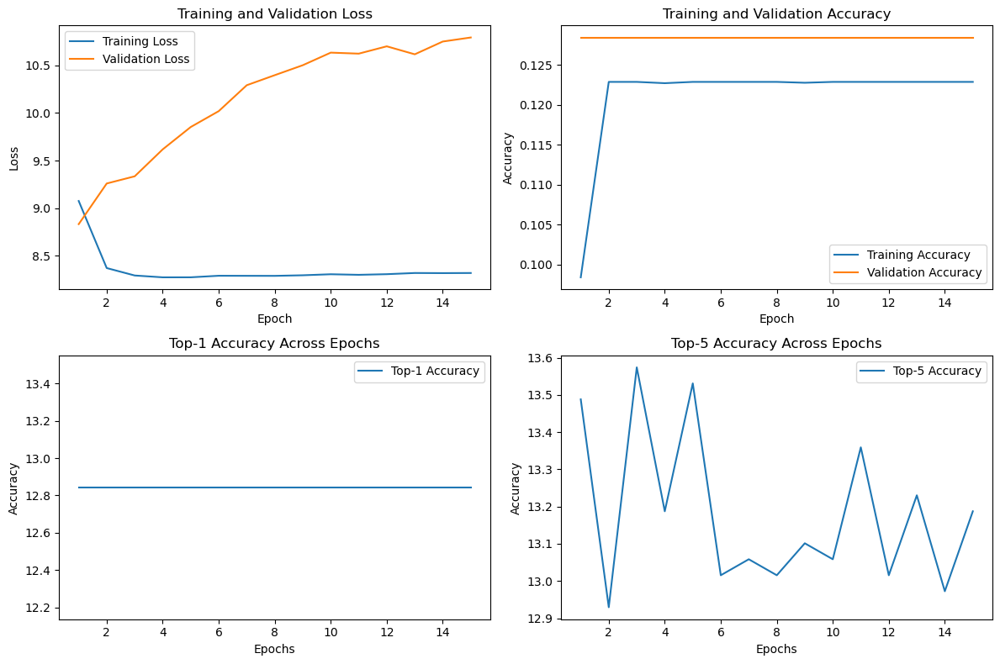

In [21]:
# Plotting
plt.figure(figsize=(12, 8))

# Plot training and validation losses
plt.subplot(2, 2, 1)
plt.plot(range(1, num_epochs + 1), train_losses, label='Training Loss')
plt.plot(range(1, num_epochs + 1), val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()

# Plot training and validation accuracies
plt.subplot(2, 2, 2)
plt.plot(range(1, num_epochs + 1), train_accuracies, label='Training Accuracy')
plt.plot(range(1, num_epochs + 1), val_accuracies, label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy')
plt.legend()

plt.subplot(2, 2, 3)
plt.plot(range(1, num_epochs+1), val_top1_accuracies, label='Top-1 Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Top-1 Accuracy Across Epochs')
plt.legend()

plt.subplot(2, 2, 4)
plt.plot(range(1, num_epochs+1), val_top5_accuracies, label='Top-5 Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Top-5 Accuracy Across Epochs')
plt.legend()

plt.tight_layout()
plt.show()